In [13]:
import os
from pathlib import Path
import tifffile as tf
from IPython.display import display, Image
from gvxrPython3 import gvxr, json2gvxr

In [2]:
# Initialise gVXR
json2gvxr.initGVXR("../JSON/2StrokeEngine.json")

Create an OpenGL context: 800x450


Thu Oct 13 11:33:37 2022 ---- Create window (ID: -1)
Thu Oct 13 11:33:37 2022 ---- Initialise GLFW
Thu Oct 13 11:33:37 2022 ---- Create an OpenGL window with a 3.2 context.
Thu Oct 13 11:33:37 2022 ---- Make the window's context current
Thu Oct 13 11:33:37 2022 ---- Initialise GLEW
Thu Oct 13 11:33:37 2022 ---- OpenGL vendor: NVIDIA Corporation
Thu Oct 13 11:33:37 2022 ---- OpenGL renderer: NVIDIA GeForce RTX 2080 Ti/PCIe/SSE2
Thu Oct 13 11:33:37 2022 ---- OpenGL version: 3.2.0 NVIDIA 515.48.07
Thu Oct 13 11:33:37 2022 ---- Use OpenGL 4.5.
Thu Oct 13 11:33:37 2022 ---- Initialise the X-ray renderer if needed and if possible


In [3]:
# Setup scan from json
json2gvxr.initDetector("../JSON/2StrokeEngine.json")
json2gvxr.initSourceGeometry()
json2gvxr.initSpectrum()
json2gvxr.initSamples()
json2gvxr.initScan()

Set up the detector
	Detector position: [0, -150, 0, 'mm']
	Detector up vector: [0, 0, 1]
	Detector number of pixels: [900, 900]
	Pixel spacing: [0.5, 0.5, 'mm']
Set up the beam
	Source position: [0, 600, 0, 'mm']
	Source shape: Point
Set up the CT Scan


Thu Oct 13 11:33:41 2022 ---- Initialise the renderer
Thu Oct 13 11:33:41 2022 ---- file_name:	../input_data/2StrokeEngine/BottomRod.stl	nb_faces:	1912	nb_vertices:	5736	bounding_box (in cm):	(-3.72062, -1, -12.9196)	(3.72062, 1, -9.31045)
Thu Oct 13 11:33:41 2022 ---- file_name:	../input_data/2StrokeEngine/ConnectingRod.stl	nb_faces:	3560	nb_vertices:	10680	bounding_box (in cm):	(-3.72062, -1, -9.31045)	(3.72062, 1, 4.36464)
Thu Oct 13 11:33:41 2022 ---- file_name:	../input_data/2StrokeEngine/CrankShaft.stl	nb_faces:	2832	nb_vertices:	8496	bounding_box (in cm):	(-5.48201, -7.5, -12.7303)	(5.48201, 7.5, 0.998329)
Thu Oct 13 11:33:41 2022 ---- file_name:	../input_data/2StrokeEngine/Piston.stl	nb_faces:	36162	nb_vertices:	108486	bounding_box (in cm):	(-3.5, -3.49876, 1.86945)	(3.5, 3.49876, 7.256)
Thu Oct 13 11:33:41 2022 ---- file_name:	../input_data/2StrokeEngine/WristPin.stl	nb_faces:	204	nb_vertices:	612	bounding_box (in cm):	(-0.49, -2.2, 2.68302)	(0.49, 2.2, 3.65588)


In [4]:
# Preview

gvxr.computeXRayImage()
gvxr.displayScene()

In [5]:
# Perform CT scan

# To create a preview animation, add the following to the TurboPump json's
# Scan key. This will dramatically slow down the scan!
# "GifPath": "./input_data/2StrokeEngine/scan/preview.gif"

# Also; disabling verbosity will also speed up the scan. (But won't show
# progress)
angles = json2gvxr.doCTScan(verbose=False)
print("Scan complete!")

Scan complete!


In [6]:
# Save angles to file
with open("../input_data/2StrokeEngine/scan/angles.csv", "w") as f:
    f.writelines([ f"{x}\n" for x in angles])

In [7]:
# apply flatfields to files
print("Performing flatfield correction...")
for f in Path("../input_data/2StrokeEngine/projections/").glob("*.tiff"):
    tf.imwrite(tf.imread(f) / gvxr.getTotalEnergyWithDetectorResponse())


Performing flatfield correction...


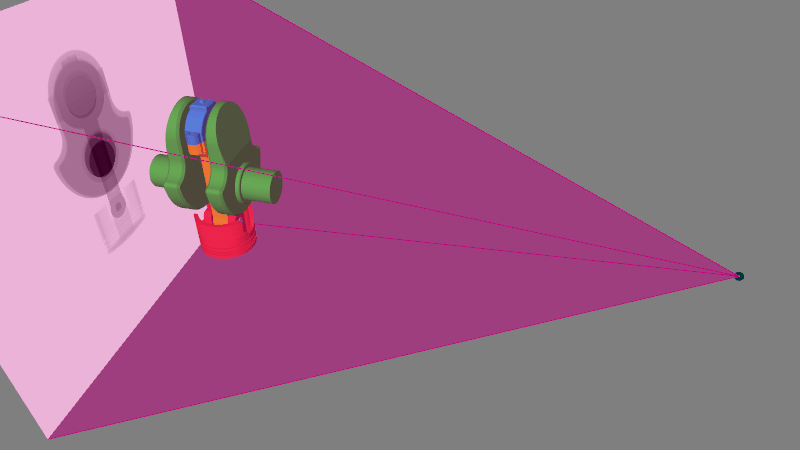

In [15]:
if os.path.exists("../input_data/2StrokeEngine/scan/preview.gif"):
    with open('../input_data/2StrokeEngine/scan/preview.gif','rb') as f:
        display(Image(data=f.read(), format='png', width=1000))

In [8]:
gvxr.terminate()

Thu Oct 13 11:37:47 2022 ---- Destroy all the windows
Thu Oct 13 11:37:47 2022 ---- Destroy window 0(0x555c02766d20)
